In [1]:
import numpy as np
import librosa
import IPython.display as ipd
import matplotlib.pyplot as plt
from scipy.signal import fftconvolve, decimate
from scipy import interpolate
from sklearn.decomposition import PCA
import sys
import time
sys.path.append("..")
from SlidingWindow import *
from CurvatureTools import *
from Sunspot import *
%matplotlib notebook

<IPython.core.display.Javascript object>


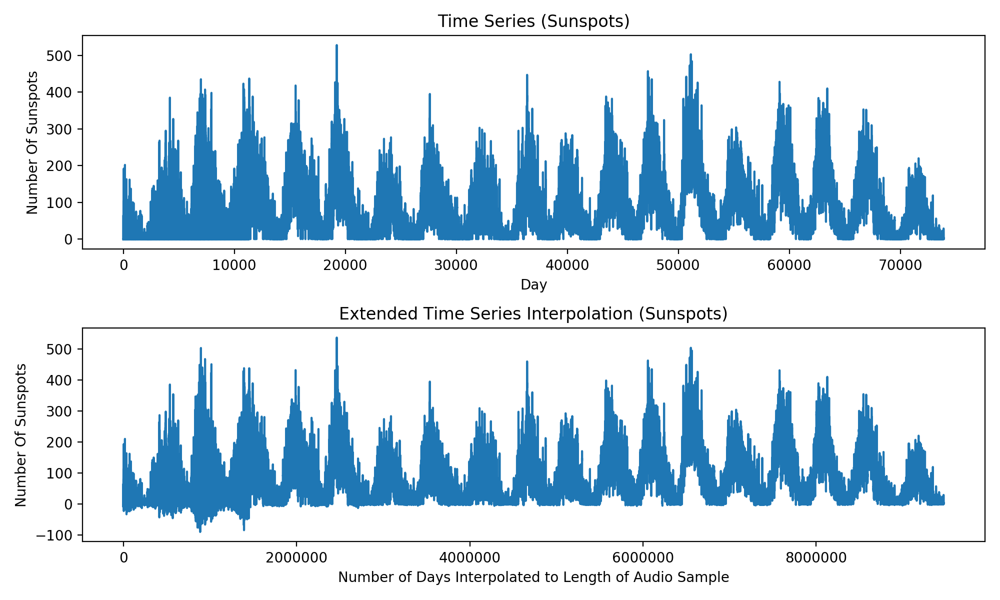

<IPython.core.display.Javascript object>


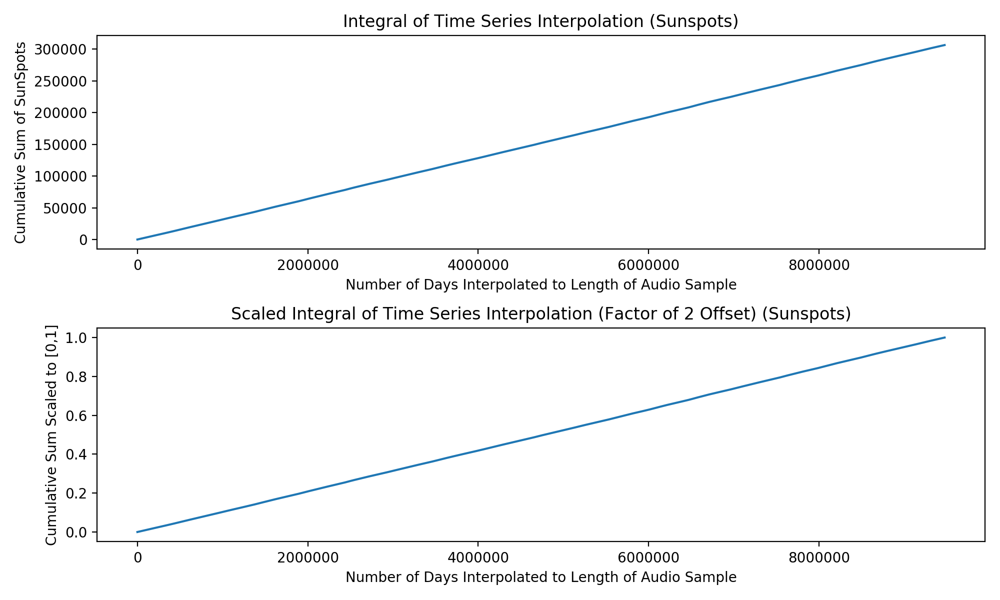

<IPython.core.display.Javascript object>


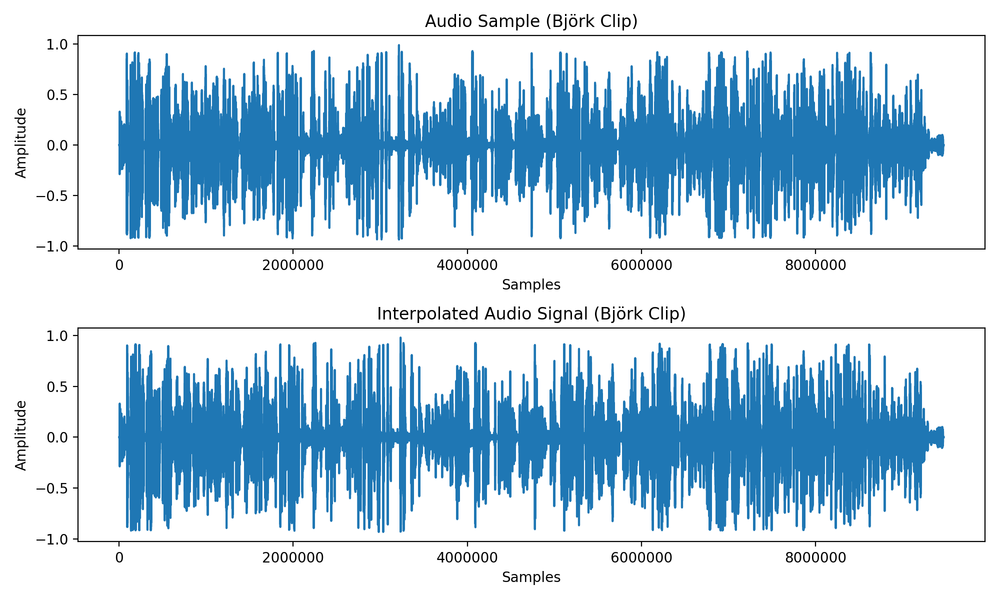

In [30]:
TS = extractData()

fs = 44100
AS, sr = librosa.load("bjork.wav", sr=fs)

#Interpolate Time Series to size of Audio Sample
fac = len(AS)/len(TS)
N = len(TS)
x = np.linspace(0, 1, N)
f = interpolate.interp1d(x,TS,kind='cubic')
xnew = np.linspace(0, 1, int(fac*N))
NTS = f(xnew)

#take cumsum of interpolated A
SNTS = positive_data_scale(NTS,2)
SInteg = np.cumsum(SNTS, axis=0)/fs
scale = SInteg[len(SInteg)-1]
SSTS = SInteg / scale

lA = len(AS)
xA = np.linspace(0, 1, lA)
fA = interpolate.interp1d(xA,AS,kind='cubic')
IAS = fA(SSTS)

plt.figure(figsize=(10, 6))
plt.subplot(211)
plt.plot(TS)
plt.xlabel("Day")
plt.ylabel("Number Of Sunspots")
plt.title("Time Series (Sunspots)")
plt.subplot(212)
plt.plot(NTS)
plt.xlabel("Number of Days Interpolated to Length of Audio Sample")
plt.ylabel("Number Of Sunspots")
plt.title("Extended Time Series Interpolation (Sunspots)")
plt.tight_layout()

plt.figure(figsize=(10,6))
plt.subplot(211)
plt.plot(SInteg)
plt.xlabel("Number of Days Interpolated to Length of Audio Sample")
plt.ylabel("Cumulative Sum of SunSpots")
plt.title("Integral of Time Series Interpolation (Sunspots)")
plt.subplot(212)
plt.plot(SSTS)
plt.xlabel("Number of Days Interpolated to Length of Audio Sample")
plt.ylabel("Cumulative Sum Scaled to [0,1]")
plt.title("Scaled Integral of Time Series Interpolation (Factor of 2 Offset) (Sunspots)")
plt.tight_layout()

plt.figure(figsize=(10,6))
plt.subplot(211)
plt.plot(AS)
plt.xlabel("Samples")
plt.ylabel("Amplitude")
plt.title("Audio Sample (Björk Clip)")
plt.subplot(212)
plt.plot(IAS)
plt.xlabel("Samples")
plt.ylabel("Amplitude")
plt.title("Interpolated Audio Signal (Björk Clip)")
plt.tight_layout()


In [27]:
#Modulated Audio
ipd.Audio(IAS, rate=fs)

In [8]:
#Original Audio
ipd.Audio(AS, rate=fs)

In [28]:
save_wavfile("Björk Clip (Interpolated).wav", fs, IAS)

-32768
32616
